In [46]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import keras
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Conv2D , MaxPool2D , Flatten , Dropout , BatchNormalization
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report,confusion_matrix, f1_score, balanced_accuracy_score
from skimage.metrics import structural_similarity as ssim
from scipy.stats import spearmanr
from keras.callbacks import ReduceLROnPlateau
import cv2 
import os
from tensorflow.keras import backend as K
import gc
K.clear_session()
from glob import glob
gc.collect() 

0

# Description of the Pneumonia Dataset

The dataset is organized into 3 folders (train, test, val) and contains subfolders for each image category (Pneumonia/Normal). There are 5,863 X-Ray images (JPEG) and 2 categories (Pneumonia/Normal). Chest X-ray images (anterior-posterior) were selected from retrospective cohorts of pediatric patients of one to five years old from Guangzhou Women and Children’s Medical Center. All chest X-ray imaging was performed as part of patients’ routine clinical care. For the analysis of chest x-ray images, all chest radiographs were initially screened for quality control by removing all low quality or unreadable scans. The diagnoses for the images were then graded by two expert physicians before being cleared for training the AI system. In order to account for any grading errors, the evaluation set was also checked by a third expert.

In [47]:
labels = ['NORMAL', 'PNEUMONIA']
img_size = 150
def get_training_data(data_dir):
    'Function that gets data from a directory'
    data = []  
    labels_list = []  
    
    for label in labels:
        path = os.path.join(data_dir, label)
        class_num = labels.index(label)
        for img in os.listdir(path):
            try:
                img_arr = cv2.imread(os.path.join(path, img), cv2.IMREAD_GRAYSCALE)
                resized_arr = cv2.resize(img_arr, (img_size, img_size)) 
                data.append(resized_arr)  
                labels_list.append(class_num)  
            except Exception as e:
                print(e)

    return np.array(data), np.array(labels_list)


# Loading the Dataset

In [48]:
train_data, train_labels  = get_training_data('chest_xray/chest_xray/train')
test_data, test_labels = get_training_data('chest_xray/test')
val_data, val_labels = get_training_data('chest_xray/val')

OpenCV(4.11.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\resize.cpp:4208: error: (-215:Assertion failed) !ssize.empty() in function 'cv::resize'

OpenCV(4.11.0) D:\a\opencv-python\opencv-python\opencv\modules\imgproc\src\resize.cpp:4208: error: (-215:Assertion failed) !ssize.empty() in function 'cv::resize'



# Data Visualization & Preprocessing

Note that the data is imbalanced

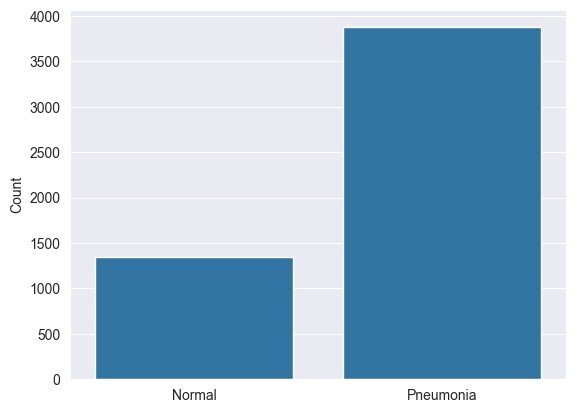

In [49]:
label_map = {1: "Pneumonia", 0: "Normal"}
l = [label_map[label] for label in train_labels]

sns.set_style('darkgrid')
sns.countplot(x=l)
plt.ylabel("Count")
plt.show()

## Examples

We plot a few examples.

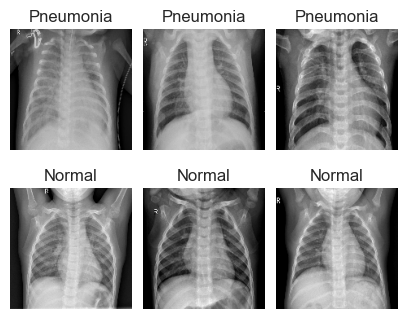

In [50]:
pneumonia_images = [train_data[i] for i in range(len(train_labels)) if train_labels[i] == 1]
normal_images = [train_data[i] for i in range(len(train_labels)) if train_labels[i] == 0]

plt.figure(figsize=(5, 5))
for i in range(3):
    plt.subplot(2, 3, i+1) 
    plt.imshow(pneumonia_images[i].reshape(img_size, img_size), cmap='gray')
    plt.title("Pneumonia")
    plt.axis('off')  

for i in range(3):
    plt.subplot(2, 3, i+4) 
    plt.imshow(normal_images[i].reshape(img_size, img_size), cmap='gray')
    plt.title("Normal")
    plt.axis('off') 

plt.subplots_adjust(hspace=-0.3, wspace=0.1)
plt.show()

We perform a grayscale normalization to reduce the effect of illumination's differences. More over we perform scaling since NN are initialized to work well on $[0,1]$.

In [51]:
# Normalize the data
x_train = np.array(train_data) / 255
x_val = np.array(val_data) / 255
x_test = np.array(test_data) / 255

# Further Preprocessing
## Reshaping Image Data 
The deep learning model needs the image data in the format (num_samples, height, width, channels) to work with convolution layers effectively. Grayscale images need to have a channel dimension (which is 1), so they are reshaped accordingly.

## Converting Labels to NumPy Arrays
Deep learning frameworks need labels in a numerical format (as NumPy arrays or tensors), and they must be able to index and manipulate the labels efficiently during training and evaluation.

## What Happens After Reshaping:
After this block of code, your data will be in the proper format:
x_train, x_val, x_test: 4D arrays of shape (num_samples, img_size, img_size, 1), suitable for feeding into a neural network.
y_train, y_val, y_test: 1D arrays containing the labels, which are also ready to be used for training or evaluation.

In [52]:

x_train = x_train.reshape(-1, img_size, img_size, 1)
y_train = np.array(train_labels)

x_val = x_val.reshape(-1, img_size, img_size, 1)
y_val = np.array(val_labels)

x_test = x_test.reshape(-1, img_size, img_size, 1)
y_test = np.array(test_labels)

# Data Augmentation
Lastly we perform data augmentation.

In [53]:
datagen = ImageDataGenerator(
        featurewise_center=False,  # set input mean to 0 over the dataset
        samplewise_center=False,  # set each sample mean to 0
        featurewise_std_normalization=False,  # divide inputs by std of the dataset
        samplewise_std_normalization=False,  # divide each input by its std
        zca_whitening=False,  # apply ZCA whitening
        rotation_range = 30,  # randomly rotate images in the range (degrees, 0 to 180)
        zoom_range = 0.2, # Randomly zoom image 
        width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
        height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
        horizontal_flip = True,  # randomly flip images
        vertical_flip=False)  # randomly flip images


datagen.fit(x_train)

## Model
This model is a Convolutional Neural Network (CNN) designed for binary classification tasks, typically used in image classification. It consists of several layers aimed at extracting features from input images:

1. **Convolutional Layers**: The model uses multiple convolutional layers with increasing numbers of filters (32, 64, 128, 256), each applying 3x3 kernels to extract spatial features. These layers help in identifying patterns such as edges, textures, and more complex shapes in the images.

2. **Max-Pooling Layers**: After each convolutional block, max-pooling is applied to reduce the spatial dimensions of the feature maps, which helps in reducing computational load and controlling overfitting. The pooling size is 2x2 with a stride of 2.

3. **Batch Normalization**: This layer is used after each convolutional block to normalize the activations, which helps speed up training and stabilizes the learning process.

4. **Dropout Layers**: Dropout is used in several layers (0.1 or 0.2) to prevent overfitting. It randomly deactivates a fraction of neurons during training, forcing the model to generalize better.

5. **Flattening**: After feature extraction, the 2D feature maps are flattened into a 1D vector to be fed into fully connected (dense) layers.

6. **Dense Layers**: The model has one fully connected layer with 128 units and a ReLU activation function, followed by another dropout layer to improve generalization. The output layer is a single neuron with a sigmoid activation function, providing a probability value between 0 and 1 for binary classification.

7. **Model Compilation**: The model uses the RMSprop optimizer and binary crossentropy loss function, which are appropriate for binary classification problems. The metric used for evaluation is accuracy.

Overall, this CNN model is structured to extract hierarchical features from input images and classify them into two categories with high accuracy, using techniques like batch normalization, dropout, and max-pooling to improve training efficiency and prevent overfitting.

In [54]:
model = Sequential()
model.add(Conv2D(32 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu' , input_shape = (150,150,1)))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(64 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(Dropout(0.1))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(64 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(128 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(Dropout(0.2))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Conv2D(256 , (3,3) , strides = 1 , padding = 'same' , activation = 'relu'))
model.add(Dropout(0.2))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2) , strides = 2 , padding = 'same'))
model.add(Flatten())
model.add(Dense(units = 128 , activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(units = 1 , activation = 'sigmoid'))
model.compile(optimizer = "rmsprop" , loss = 'binary_crossentropy' , metrics = ['accuracy'])

C:\Users\salom\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


# Training

Note that we introduced a weight to punish erros on normal patients $2.75$ more since we are dealing with a class imbalance.

In [55]:
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', patience = 2, verbose=1,factor=0.3, min_lr=0.000001)
class_weight = { 0: 2.75, 1: 1.0 }

bool_train_cnn = False
if bool_train_cnn:
    trained_model_cnn = model.fit(datagen.flow(x_train,y_train, batch_size = 32) ,epochs = 12 , validation_data = datagen.flow(x_val, y_val) ,callbacks = [learning_rate_reduction], class_weight= class_weight)
    model.save('part2_models/part2_cnn_model.h5')
else:
    model = keras.models.load_model('part2_models/part2_cnn_model.h5')   

# Performance

We will analyze the performance of the model.

20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 76ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 70ms/step - accuracy: 0.9196 - loss: 0.2946
F1 score of the model is -  0.9367741935483871
Balanced Accuracy of the model is -  0.9183760683760684 %


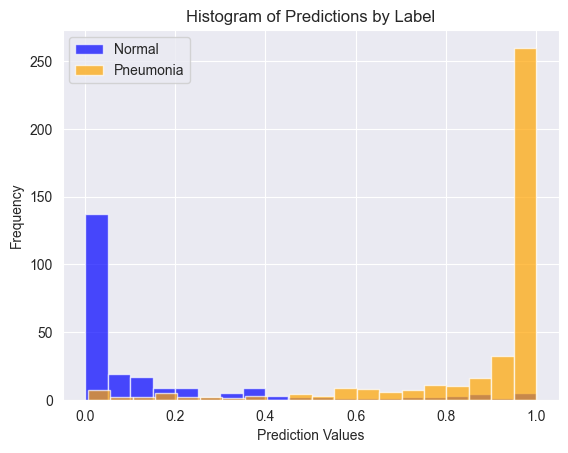

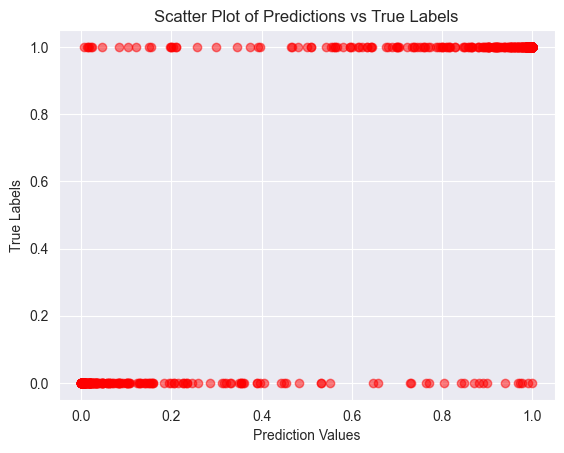

In [56]:
def plot_predictions(predictions, y_test):
    """
    Plots a histogram of prediction distributions and a scatter plot of predictions vs. true labels.

    Parameters:
    - predictions: array-like, all model predictions (used for scatter plot)
    - y_test: array-like, true labels corresponding to predictions
    """

    predictions_normal = predictions[y_test == 0]
    predictions_pneumonia = predictions[y_test == 1]

    # Histogram
    plt.hist(predictions_normal, bins=20, color='blue', alpha=0.7, label='Normal')
    plt.hist(predictions_pneumonia, bins=20, color='orange', alpha=0.7, label='Pneumonia')
    plt.title("Histogram of Predictions by Label")
    plt.xlabel("Prediction Values")
    plt.ylabel("Frequency")
    plt.legend()
    plt.show()

    # Scatter plot
    plt.scatter(predictions, y_test, alpha=0.5, color='red')
    plt.title("Scatter Plot of Predictions vs True Labels")
    plt.xlabel("Prediction Values")
    plt.ylabel("True Labels")
    plt.show()


y_pred = (model.predict(x_test) > 0.5).astype("int32") 

predictions = model.predict(x_test)
# Split predictions by label
predictions_normal = predictions[y_test == 0]
predictions_pneumonia = predictions[y_test == 1]

loss, accuracy = model.evaluate(x_test, y_test)
f1 = f1_score(y_test, y_pred)
balanced_accuracy = balanced_accuracy_score(y_test, y_pred)
print("F1 score of the model is - " , f1)
print("Balanced Accuracy of the model is - " , balanced_accuracy, "%")
plot_predictions(predictions, y_test)

# GradCAM

Grad-CAM is a technique used to visualize the regions of an image that contribute the most to the model's prediction.  It achieves this by computing the gradients of the predicted class with respect to the feature maps of the last convolutional layer. The gradients are then weighted by the average pooling of the gradients and the feature maps, resulting in a heatmap of importance scores. This heatmap can be overlaid on the input image to highlight the regions that are most relevant to the model's decision.

In [57]:
def preprocess_image(image_path, img_size=150):
    """Normalization of the picture"""
    gray = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    gray = cv2.resize(gray, (img_size, img_size))
    inp  = gray.astype(np.float32) / 255.0
    inp  = np.expand_dims(inp, axis=(0, -1))
    return inp, gray


def display_gradcam(cam, original_img, alpha=0.2, title="Grad-CAM"):
    """Display the Grad-CAM heatmap superimposed on the original image """ 
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
    superimposed_img = heatmap * alpha + original_img
    superimposed_img /= superimposed_img.max()

    plt.imshow(superimposed_img)
    plt.axis('off')
    plt.title(title)
    plt.show()

def compute_gradcam(model, image_array, conv_layer_name, class_index=0):
    """ Compute the Grad-CAM heatmap for a given image and model """
    
    conv_layer = model.get_layer(conv_layer_name)
    conv_model = keras.Model(inputs=model.inputs,
                             outputs=conv_layer.output)

    head_input = keras.Input(shape=conv_layer.output.shape[1:])
    x = head_input
    post_conv_layers = model.layers[model.layers.index(conv_layer) + 1:]
    for layer in post_conv_layers:
        x = layer(x)
    head_model = keras.Model(inputs=head_input, outputs=x)

    with tf.GradientTape() as tape:
        conv_outputs = conv_model(image_array)    
        tape.watch(conv_outputs)
        preds = head_model(conv_outputs)          
        loss = preds[0, class_index]             
    print(f"Loss: {loss}")
    grads = tape.gradient(loss, conv_outputs)    

    pooled_grads = tf.reduce_mean(grads, axis=(0,1,2))        
    conv_outputs = conv_outputs[0]                             
    weights = tf.reshape(pooled_grads, (1,1,-1))               
    cam = tf.reduce_sum(conv_outputs * weights, axis=-1)       
    cam = tf.nn.relu(cam).numpy()

    cam -= cam.min()
    cam /= (cam.max() + 1e-8)
    cam = cv2.resize(cam, (image_array.shape[2], image_array.shape[1]))
    return cam


## Examples

We print two examples of GradCAM for a normal and pneumonic patient.

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Loss: 0.5589920878410339


C:\Users\salom\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['input_layer']
Received: inputs=Tensor(shape=(1, 150, 150, 1))
  warnings.warn(msg)


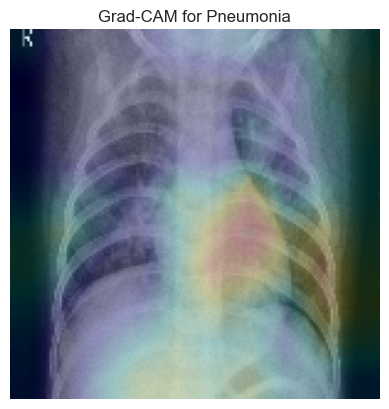

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Loss: 0.005016356706619263


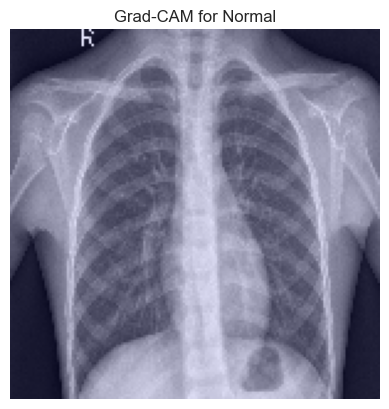

In [59]:
model = tf.keras.models.load_model('part2_models/part2_cnn_model.h5')
last_conv_layer = 'conv2d_4'  

img2, orig_gray2 = preprocess_image(os.path.join('chest_xray', 'test', 'PNEUMONIA', 'person50_virus_102.jpeg'))
pred2 = model.predict(img2)
cam2 = compute_gradcam(model, img2, last_conv_layer)
orig_rgb2 = np.stack([orig_gray2]*3, axis=-1)
display_gradcam(cam2, orig_rgb2, title="Grad-CAM for Pneumonia")


img, orig_gray = preprocess_image(os.path.join('chest_xray', 'test', 'NORMAL', 'IM-0001-0001.jpeg'))
pred = model.predict(img)
cam = compute_gradcam(model, img, last_conv_layer)
orig_rgb = np.stack([orig_gray]*3, axis=-1)
display_gradcam(cam, orig_rgb,  title="Grad-CAM for Normal")

# Data Randomization Test
We want to investigate what happens if we randomize the labels of the data. We use the same models but remove the dropout layers since we want thhat it overfitts on the training data.

In [60]:
y_train_rand = np.random.permutation(y_train) 
y_train_rand
np.save('y_train_rand.npy', y_train_rand)

model_ran = Sequential()
model_ran.add(Conv2D(32, (3,3), padding='same', activation='relu', input_shape=(150,150,1)))
model_ran.add(BatchNormalization())
model_ran.add(MaxPool2D((2,2), padding='same'))

model_ran.add(Conv2D(64, (3,3), padding='same', activation='relu'))
# dopout removed
model_ran.add(BatchNormalization())
model_ran.add(MaxPool2D((2,2), padding='same'))

model_ran.add(Conv2D(64, (3,3), padding='same', activation='relu'))
model_ran.add(BatchNormalization())
model_ran.add(MaxPool2D((2,2), padding='same'))

model_ran.add(Conv2D(128, (3,3), padding='same', activation='relu'))
# Dropout removed
model_ran.add(BatchNormalization())
model_ran.add(MaxPool2D((2,2), padding='same'))

model_ran.add(Conv2D(256, (3,3), padding='same', activation='relu'))
# Dropout removed
model_ran.add(BatchNormalization())
model_ran.add(MaxPool2D((2,2), padding='same'))

model_ran.add(Flatten())
model_ran.add(Dense(128, activation='relu'))
# Dropout removed
model_ran.add(Dense(1, activation='sigmoid'))

# Compile with Adam
model_ran.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])


C:\Users\salom\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\layers\convolutional\base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [61]:
bool_train_ran = False
if bool_train_ran:
    model_ran.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    history = model_ran.fit(x_train, y_train_rand, epochs=50, batch_size=32, shuffle=True)
    print(f"Final train acc: {history.history['accuracy'][-1]:.3f}")
    model_ran.save('part2_models/part2_q5_cnn_model_ran_labels.h5')
else:
    model_ran = keras.models.load_model('part2_models/part2_q5_cnn_model_ran_labels.h5')  

In [62]:
y_pred_ran = (model_ran.predict(x_test) > 0.5).astype("int32")  # Thresholding for binary classification
# Create a histogram of model_ran.predict(x_test)
predictions_ran = model_ran.predict(x_test)

20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 71ms/step
20/20 ━━━━━━━━━━━━━━━━━━━━ 1s 64ms/step


In [63]:
loss, accuracy = model_ran.evaluate(x_test, y_test)
f1_ran = f1_score(y_test, y_pred_ran)
balanced_accuracy_ran = balanced_accuracy_score(y_test, y_pred_ran)
print("F1 score of the model is - " , f1_ran)
print("Accuracy of the model is - " , accuracy)
print("Balanced Accuracy of the model is - " , balanced_accuracy_ran, "%")

20/20 ━━━━━━━━━━━━━━━━━━━━ 2s 67ms/step - accuracy: 0.3502 - loss: 6.0797
F1 score of the model is -  0.7298170075349839
Accuracy of the model is -  0.5977563858032227
Balanced Accuracy of the model is -  0.5072649572649572 %


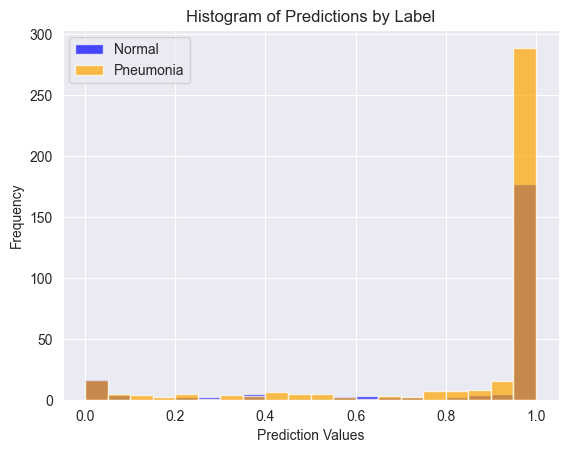

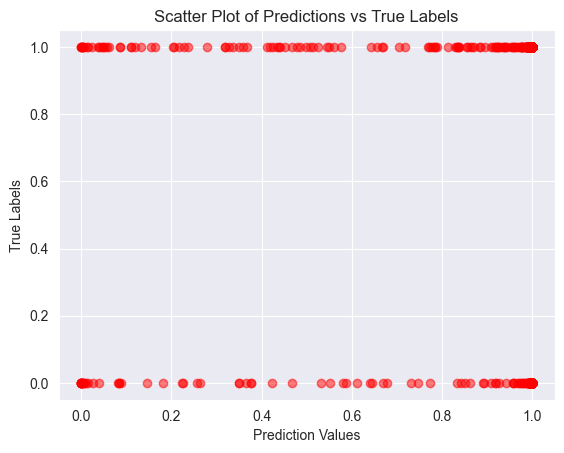

In [ ]:
plot_predictions(predictions = predictions_ran, y_test= y_test)

# Integrated Gradients
Like GradCAM this method aims explain a models prediction.

In [64]:

def integrated_gradients(model, img, target_class_idx, baseline=None, steps=50):
    """ Compute integrated gradients for a given image and model."""
    if baseline is None:
        baseline = np.zeros_like(img)

    img = img.astype(np.float32)
    baseline = baseline.astype(np.float32)
    interpolated_imgs = [(baseline + (i/steps)*(img - baseline)) for i in range(steps+1)]
    interpolated_imgs = np.array(interpolated_imgs, dtype=np.float32)

    grads = []
    for interp_img in interpolated_imgs:
        interp_img_tensor = tf.convert_to_tensor(interp_img[None, ...]) 
        with tf.GradientTape() as tape:
            tape.watch(interp_img_tensor)
            pred = model(interp_img_tensor)
            class_score = pred[0, 0]
        grad = tape.gradient(class_score, interp_img_tensor)[0] 
        grads.append(grad.numpy())
    grads = np.array(grads, dtype=np.float32)
    
    avg_grads = (grads[:-1] + grads[1:]) / 2.0
    avg_grad = np.mean(avg_grads, axis=0)
    
    integrated_grad = (img - baseline) * avg_grad
    return integrated_grad

In [65]:
def normalize(arr):
    arr = np.abs(arr)
    arr = arr / (np.max(arr) + 1e-8)
    return arr

img = x_test[0]
label = y_test[0]
baseline = np.zeros_like(img) 
preds_rand = model.predict(np.expand_dims(img, axis=0))
preds_rand = model.predict(np.expand_dims(img, axis=0))
target_class_rand = int(preds_rand> 0.5)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


C:\Users\salom\AppData\Local\Temp\ipykernel_21248\2717821421.py:11: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  target_class_rand = int(preds_rand> 0.5)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Model 1 Prediction: [[0.00501636]], Class Index: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Model 1 Prediction: [[1.]], Class Index: 1


C:\Users\salom\AppData\Local\Temp\ipykernel_21248\1830905560.py:17: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  class_idx1 = int(preds1 > 0.5)
C:\Users\salom\AppData\Local\Temp\ipykernel_21248\1830905560.py:22: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  class_idx2 = int(preds2 > 0.5)


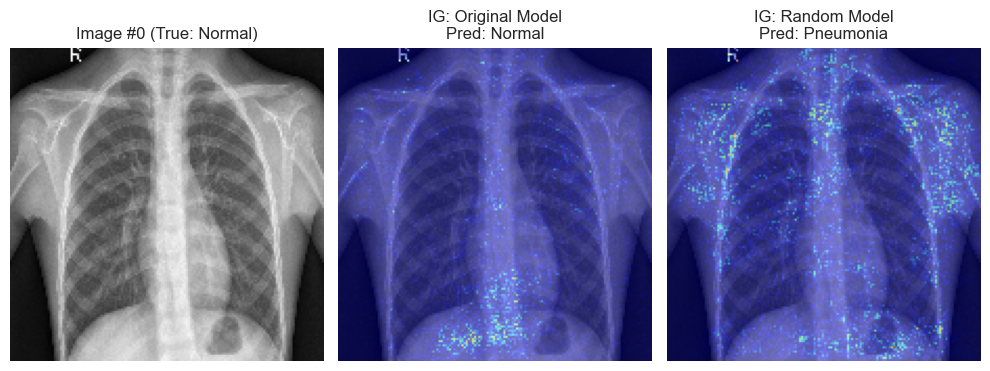

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Model 1 Prediction: [[7.555855e-05]], Class Index: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Model 1 Prediction: [[0.999963]], Class Index: 1


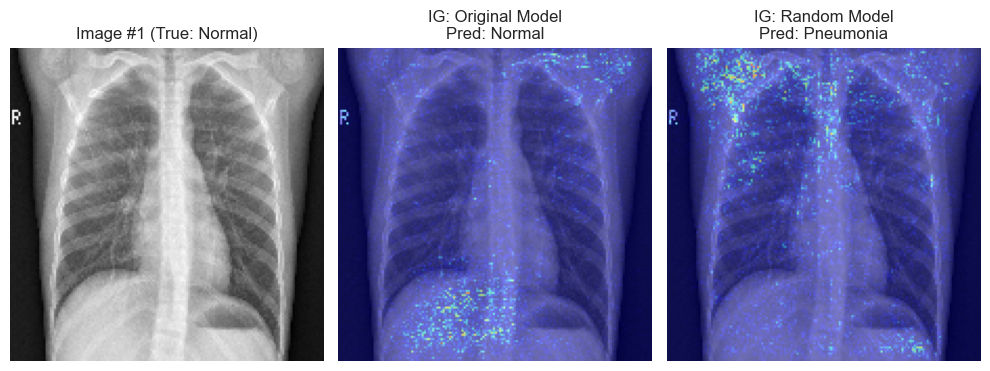

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Model 1 Prediction: [[0.0064578]], Class Index: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
Model 1 Prediction: [[0.9999999]], Class Index: 1


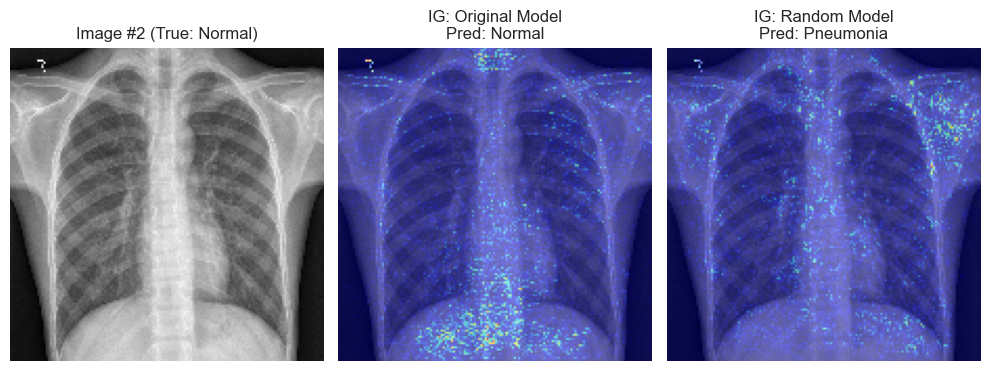

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
Model 1 Prediction: [[0.01034089]], Class Index: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Model 1 Prediction: [[0.36542466]], Class Index: 0


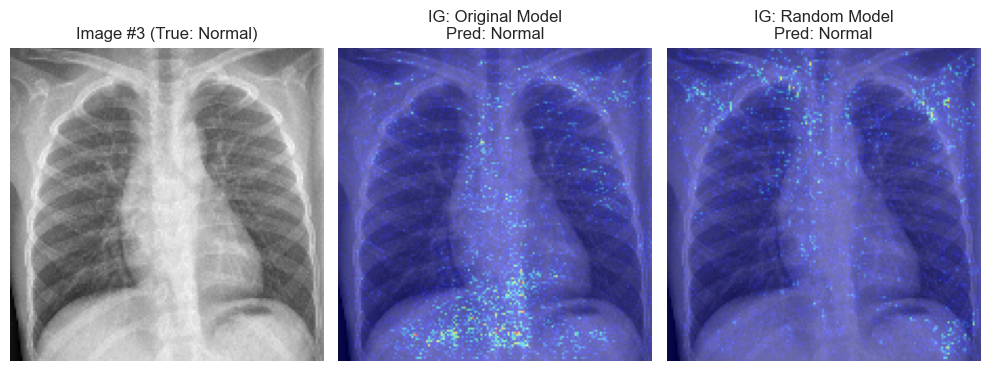

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
Model 1 Prediction: [[0.00867693]], Class Index: 0
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Model 1 Prediction: [[0.9999987]], Class Index: 1


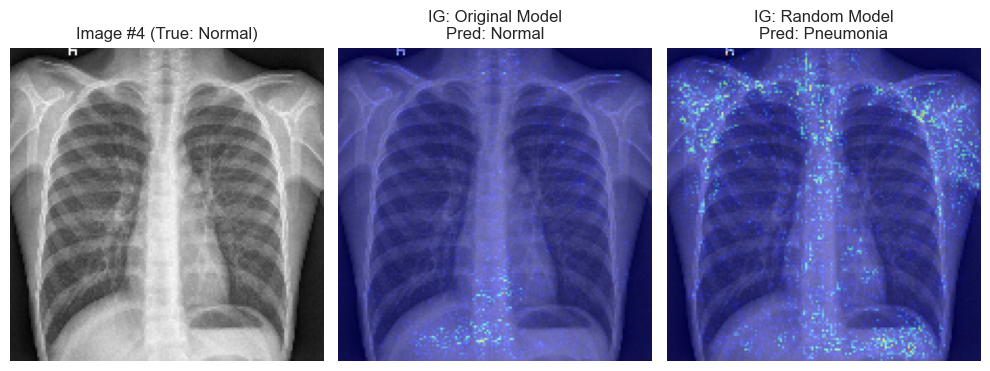

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
Model 1 Prediction: [[0.9999959]], Class Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
Model 1 Prediction: [[0.48623]], Class Index: 0


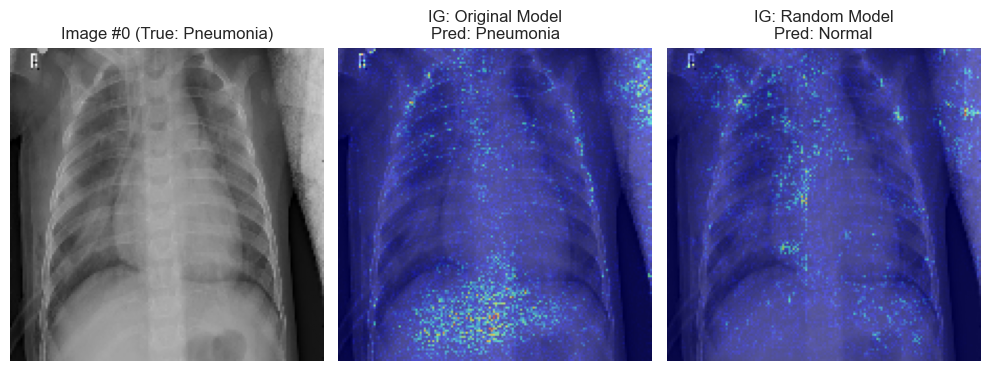

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
Model 1 Prediction: [[0.9984958]], Class Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
Model 1 Prediction: [[0.995311]], Class Index: 1


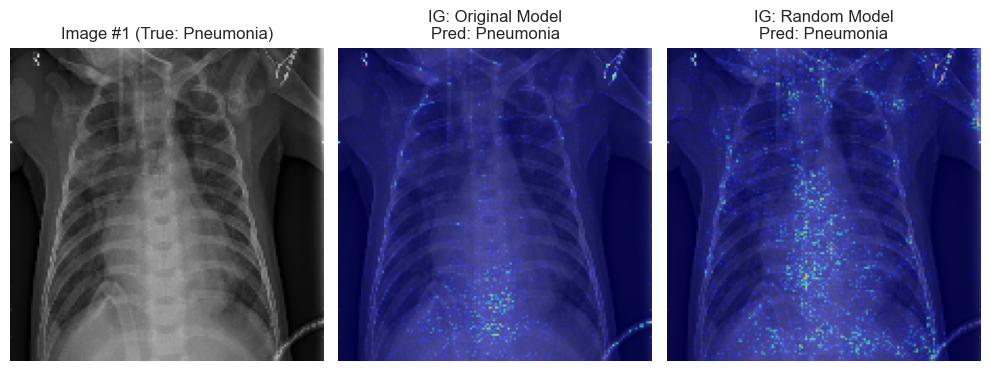

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
Model 1 Prediction: [[1.]], Class Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Model 1 Prediction: [[1.]], Class Index: 1


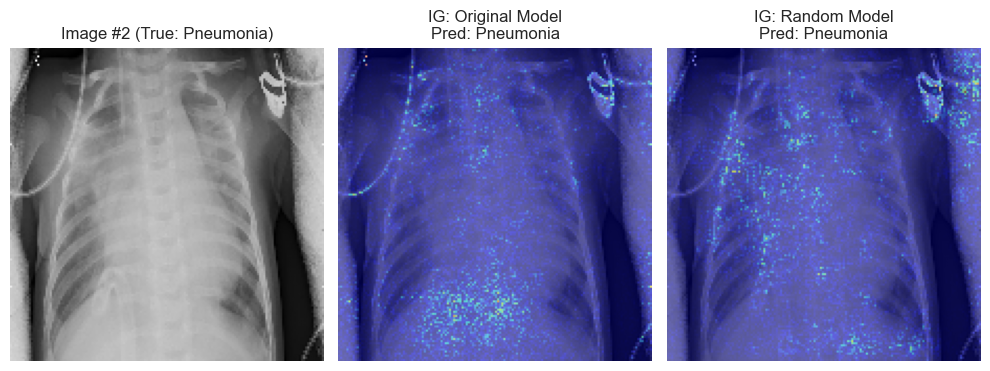

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
Model 1 Prediction: [[1.]], Class Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Model 1 Prediction: [[1.]], Class Index: 1


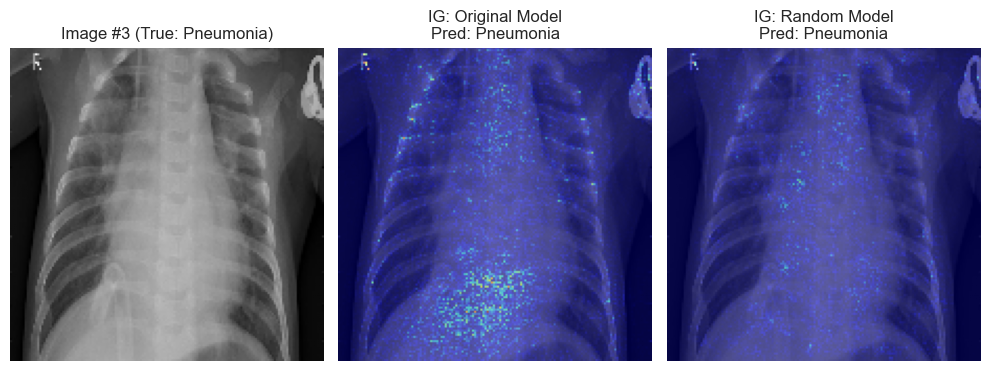

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
Model 1 Prediction: [[0.9999981]], Class Index: 1
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
Model 1 Prediction: [[0.27841264]], Class Index: 0


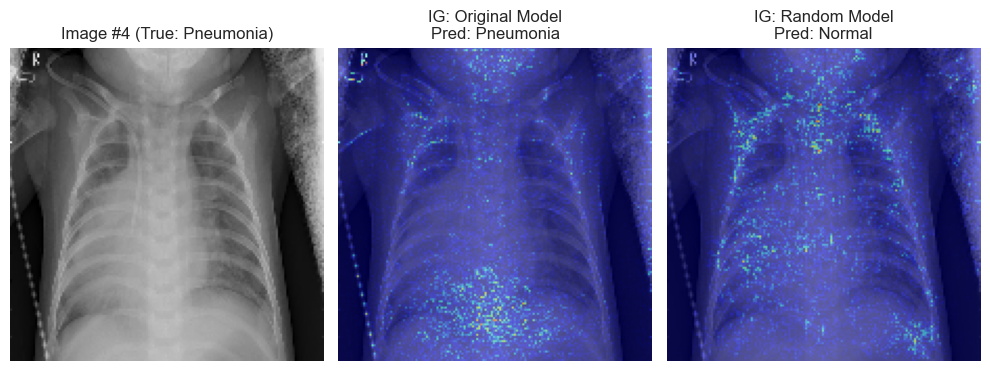

In [68]:
def compare_ig_maps(model1, model2, imgs, labels=None, class_names=None, num_images=5, return_maps=True):
    """
    Compare IG maps for model1 and model2 on multiple input images.
    Optionally return the IG maps for further analysis.

    Returns (if return_maps=True):
        ig_maps_model1: list of IG maps from model1
        ig_maps_model2: list of IG maps from model2
    """
    ig_maps_model1 = []
    ig_maps_model2 = []

    for i in range(num_images):
        img = imgs[i]
        
        preds1 = model1.predict(img[None, ...])
        class_idx1 = int(preds1 > 0.5)

        print(f"Model 1 Prediction: {preds1}, Class Index: {class_idx1}")
        
        preds2 = model2.predict(img[None, ...])
        class_idx2 = int(preds2 > 0.5)

        print(f"Model 1 Prediction: {preds2}, Class Index: {class_idx2}")

        ig_map1 = integrated_gradients(model1, img, class_idx1)
        ig_map2 = integrated_gradients(model2, img, class_idx2)

        ig_maps_model1.append(ig_map1)
        ig_maps_model2.append(ig_map2)

        plt.figure(figsize=(10, 4))

        plt.subplot(1, 3, 1)
        plt.imshow(img.squeeze(), cmap='gray')
        title = f"Image #{i}"
        if class_names and labels is not None:
            true_class = class_names[labels[i]]
            title += f" (True: {true_class})"
        plt.title(title)
        plt.axis('off')

        plt.subplot(1, 3, 2)
        plt.imshow(img.squeeze(), cmap='gray')
        plt.imshow(normalize(ig_map1), cmap='jet', alpha=0.5)
        name1 = class_names[class_idx1] if class_names else f"Class {class_idx1}"
        plt.title(f"IG: Original Model\nPred: {name1}")
        plt.axis('off')

        plt.subplot(1, 3, 3)
        plt.imshow(img.squeeze(), cmap='gray')
        plt.imshow(normalize(ig_map2), cmap='jet', alpha=0.5)
        name2 = class_names[class_idx2] if class_names else f"Class {class_idx2}"
        plt.title(f"IG: Random Model\nPred: {name2}")
        plt.axis('off')

        plt.tight_layout()
        plt.savefig(f"comparison_image_{i}.png", dpi=300, bbox_inches='tight')
        plt.show()
    
    if return_maps:
        return ig_maps_model1, ig_maps_model2

class_names = ["Normal", "Pneumonia"]
x_test_subset = x_test[0:5]  
label_subset = y_test[0:5] 
ig_maps = compare_ig_maps(model, model_ran, x_test_subset, labels=label_subset, class_names=class_names, num_images=5)
x_test_subset = x_test[613:618] 
label_subset = y_test[613:618] 
ig_maps = compare_ig_maps(model, model_ran, x_test_subset, labels=label_subset, class_names=class_names, num_images=5)

# GRAD CAM, RANDOM GUESSING

We investigate the random label CNN. We print a few examples of GradCAM and IG for this model

In [71]:
last_conv_layer = 'conv2d_14' 

In [72]:
from glob import glob

def run_gradcam_on_image(filename, model, last_conv_layer):
    img, orig_gray = preprocess_image(filename)
    pred = model.predict(img)
    print(f"File: {os.path.basename(filename)} | Predicted class: {pred[0]}")
    cam = compute_gradcam(model, img, last_conv_layer)
    orig_rgb = np.stack([orig_gray] * 3, axis=-1)
    display_gradcam(cam, orig_rgb, title=f"Grad-CAM for {os.path.basename(filename)}")

# Define directories
normal_dir = os.path.join('chest_xray', 'test', 'NORMAL')
pneumonia_dir = os.path.join('chest_xray', 'test', 'PNEUMONIA')

# Get first 20 image file paths from each directory
normal_images = sorted(glob(os.path.join(normal_dir, '*.jpeg')))[:20]
pneumonia_images = sorted(glob(os.path.join(pneumonia_dir, '*.jpeg')))[:20]

# Combine the two lists
all_images = normal_images + pneumonia_images

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
File: IM-0001-0001.jpeg | Predicted class: [1.]
Loss: 1.0


C:\Users\salom\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['input_layer_2']
Received: inputs=Tensor(shape=(1, 150, 150, 1))
  warnings.warn(msg)


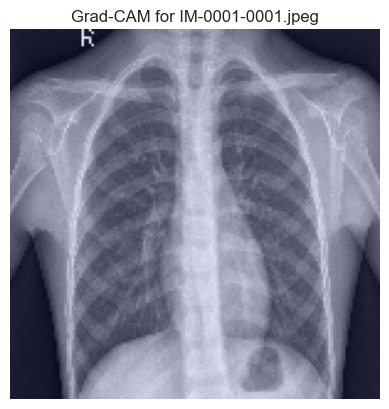

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
File: IM-0003-0001.jpeg | Predicted class: [0.999963]
Loss: 0.9999629855155945


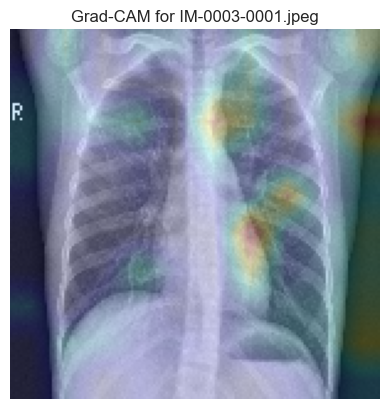

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
File: IM-0005-0001.jpeg | Predicted class: [0.9999999]
Loss: 0.9999998807907104


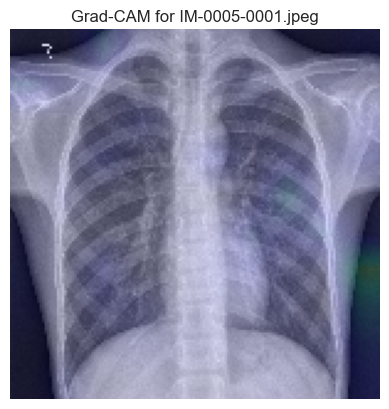

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: IM-0006-0001.jpeg | Predicted class: [0.36542466]
Loss: 0.3654246926307678


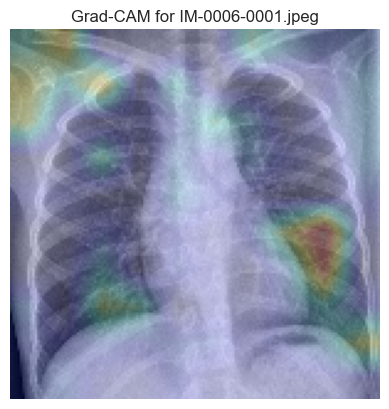

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
File: IM-0007-0001.jpeg | Predicted class: [0.9999987]
Loss: 0.9999986886978149


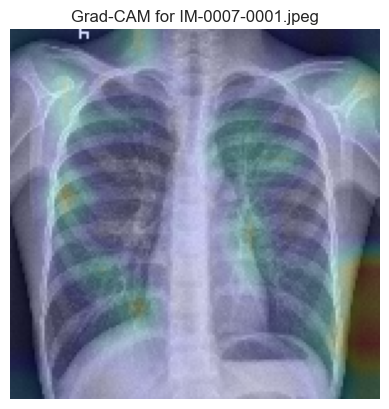

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
File: IM-0009-0001.jpeg | Predicted class: [0.99998546]
Loss: 0.9999854564666748


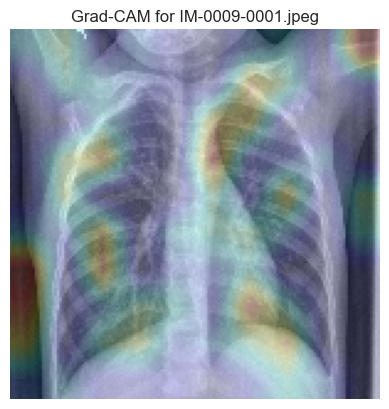

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
File: IM-0010-0001.jpeg | Predicted class: [0.99252146]
Loss: 0.9925214648246765


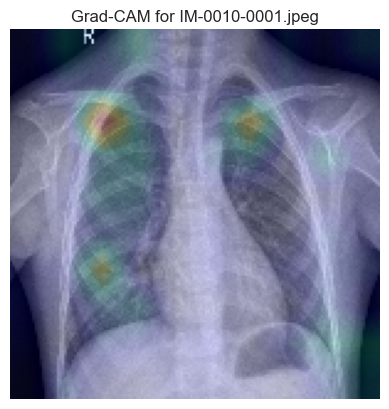

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
File: IM-0011-0001-0001.jpeg | Predicted class: [0.99999964]
Loss: 0.9999996423721313


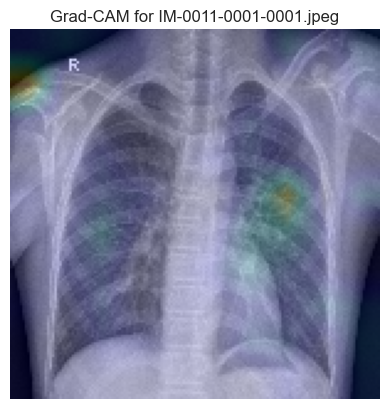

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
File: IM-0011-0001-0002.jpeg | Predicted class: [0.8522599]
Loss: 0.8522598743438721


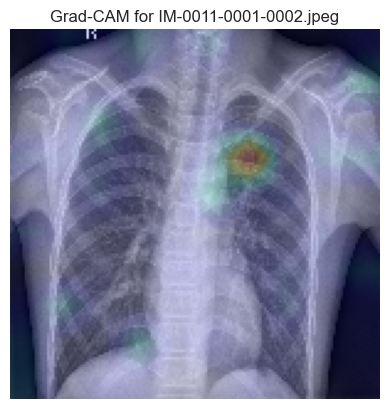

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
File: IM-0011-0001.jpeg | Predicted class: [0.99999547]
Loss: 0.9999954700469971


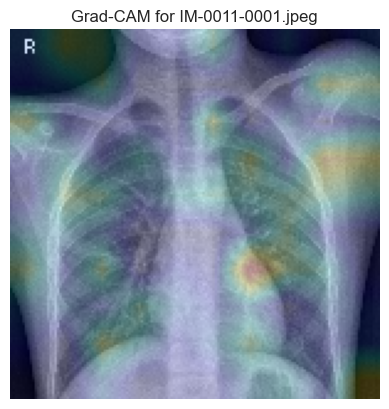

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: IM-0013-0001.jpeg | Predicted class: [0.9999782]
Loss: 0.9999781847000122


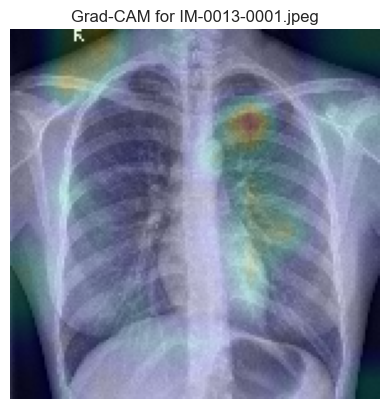

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
File: IM-0015-0001.jpeg | Predicted class: [0.9999939]
Loss: 0.9999939203262329


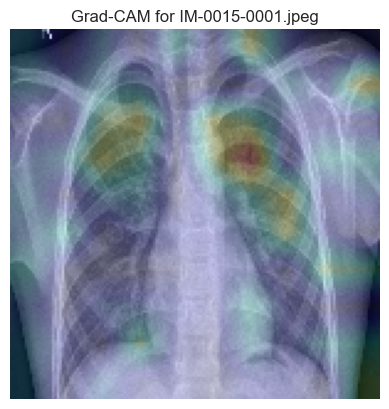

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
File: IM-0016-0001.jpeg | Predicted class: [0.976509]
Loss: 0.9765089750289917


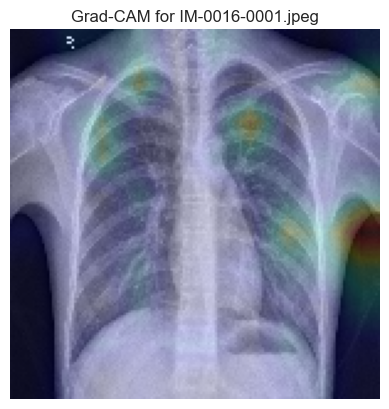

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: IM-0017-0001.jpeg | Predicted class: [0.99999964]
Loss: 0.9999996423721313


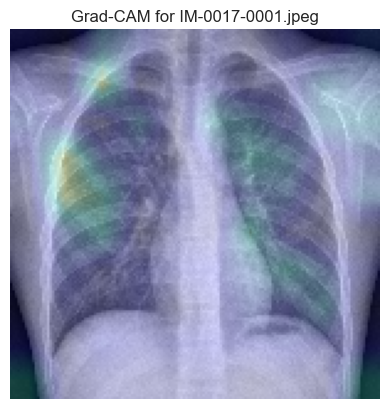

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: IM-0019-0001.jpeg | Predicted class: [1.]
Loss: 1.0


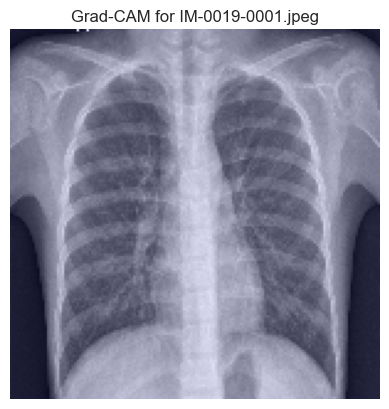

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
File: IM-0021-0001.jpeg | Predicted class: [0.99966633]
Loss: 0.9996663331985474


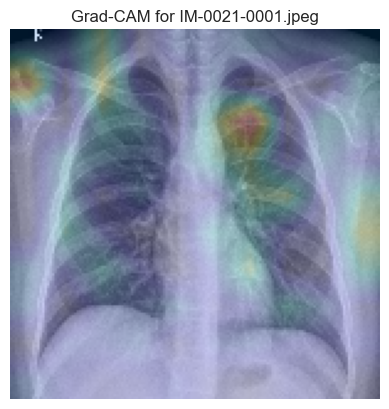

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: IM-0022-0001.jpeg | Predicted class: [0.9999956]
Loss: 0.9999955892562866


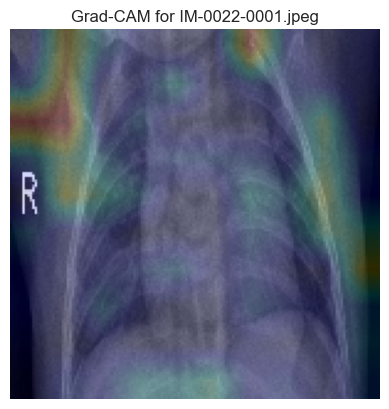

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
File: IM-0023-0001.jpeg | Predicted class: [0.9998028]
Loss: 0.999802827835083


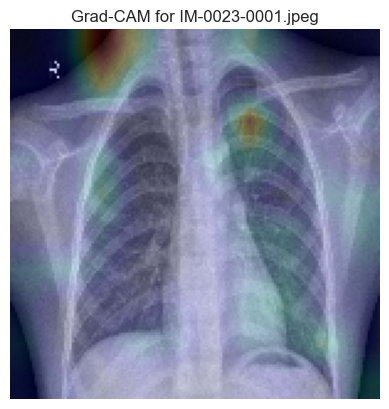

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
File: IM-0025-0001.jpeg | Predicted class: [0.98973393]
Loss: 0.9897339344024658


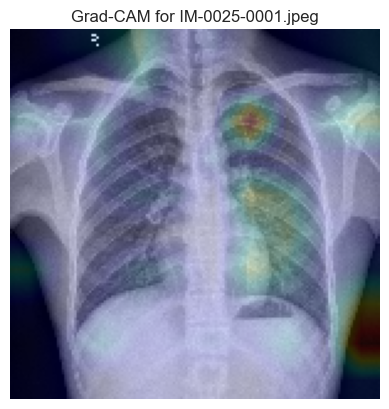

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
File: IM-0027-0001.jpeg | Predicted class: [0.9969199]
Loss: 0.9969198703765869


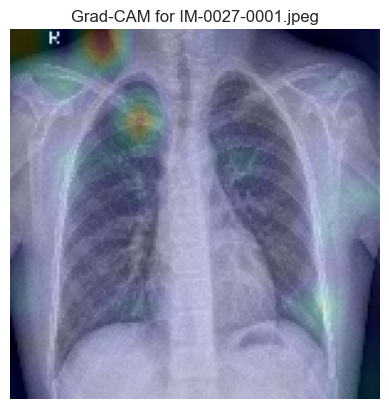

In [73]:
# Run Grad-CAM on each image
for img_path in normal_images:
    run_gradcam_on_image(img_path, model=model_ran, last_conv_layer=last_conv_layer) 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
File: person100_bacteria_475.jpeg | Predicted class: [0.92452204]
Loss: 0.9245220422744751


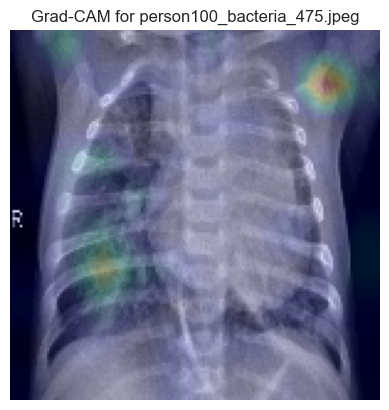

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
File: person100_bacteria_477.jpeg | Predicted class: [0.99736613]
Loss: 0.9973661303520203


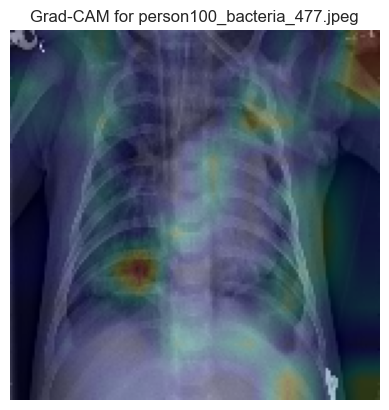

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
File: person100_bacteria_478.jpeg | Predicted class: [0.9997334]
Loss: 0.9997333884239197


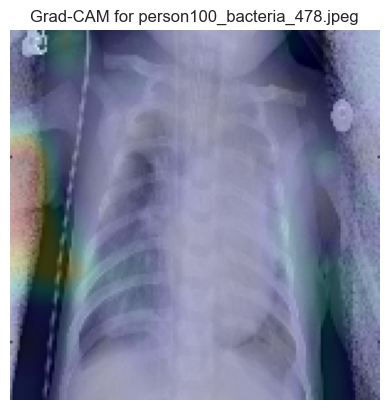

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
File: person100_bacteria_479.jpeg | Predicted class: [0.05778061]
Loss: 0.05778060853481293


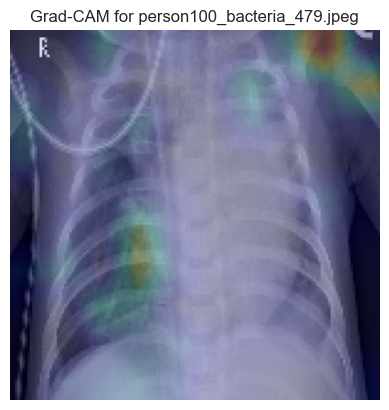

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
File: person100_bacteria_480.jpeg | Predicted class: [0.04814458]
Loss: 0.04814458638429642


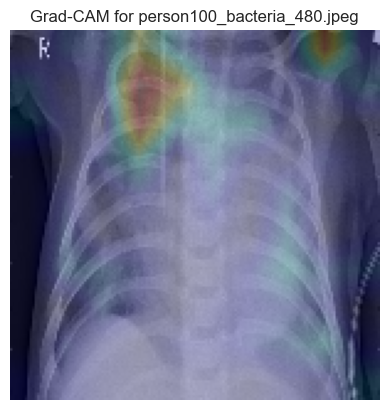

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
File: person100_bacteria_481.jpeg | Predicted class: [0.97283953]
Loss: 0.9728395342826843


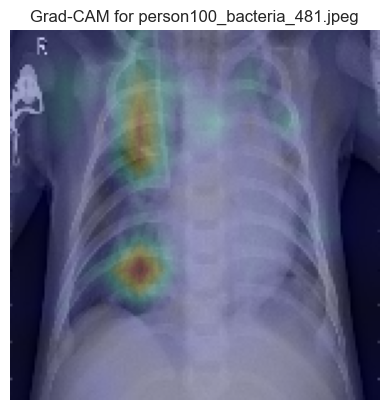

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
File: person100_bacteria_482.jpeg | Predicted class: [0.4793094]
Loss: 0.47930940985679626


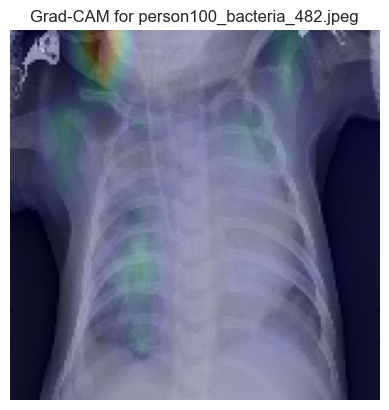

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
File: person101_bacteria_483.jpeg | Predicted class: [0.9999961]
Loss: 0.9999961256980896


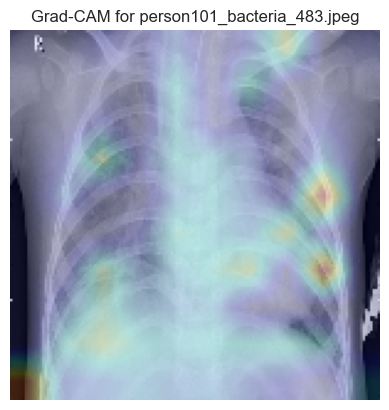

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: person101_bacteria_484.jpeg | Predicted class: [0.99999493]
Loss: 0.9999949336051941


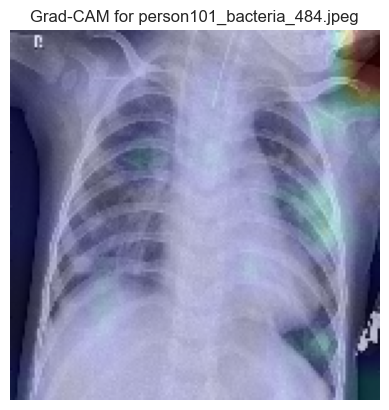

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
File: person101_bacteria_485.jpeg | Predicted class: [0.9999999]
Loss: 0.9999998807907104


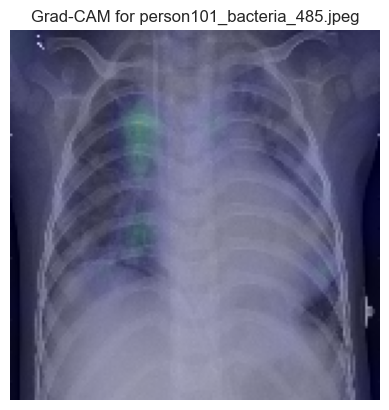

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
File: person101_bacteria_486.jpeg | Predicted class: [0.95484024]
Loss: 0.9548402428627014


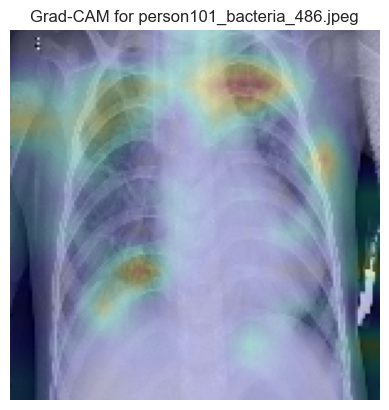

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
File: person102_bacteria_487.jpeg | Predicted class: [1.]
Loss: 1.0


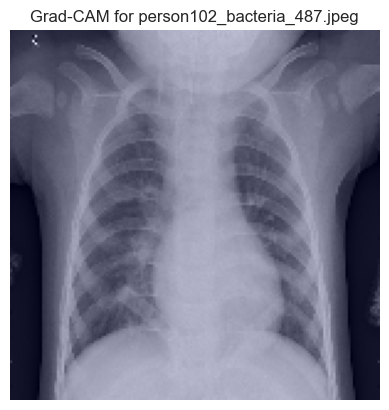

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
File: person103_bacteria_488.jpeg | Predicted class: [0.9999661]
Loss: 0.9999660849571228


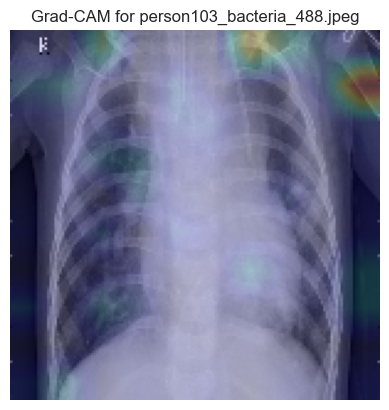

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
File: person103_bacteria_489.jpeg | Predicted class: [0.03983755]
Loss: 0.0398375429213047


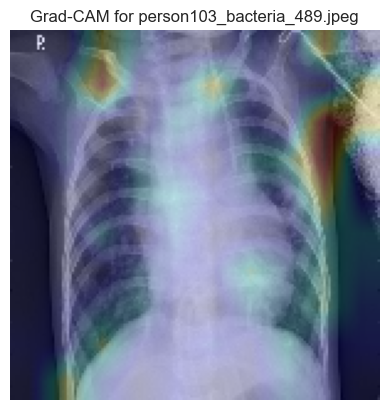

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
File: person103_bacteria_490.jpeg | Predicted class: [0.00025379]
Loss: 0.0002537912514526397


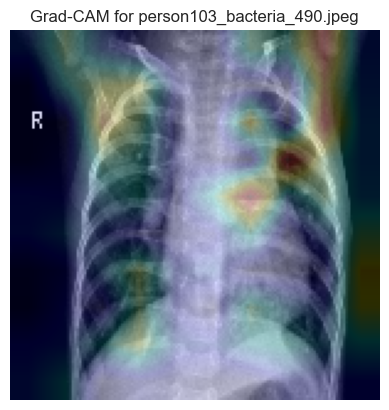

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
File: person104_bacteria_491.jpeg | Predicted class: [0.998804]
Loss: 0.998803973197937


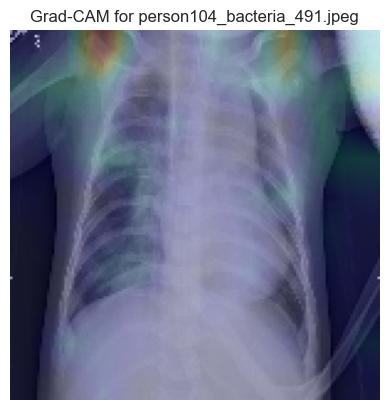

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
File: person104_bacteria_492.jpeg | Predicted class: [0.21674795]
Loss: 0.21674798429012299


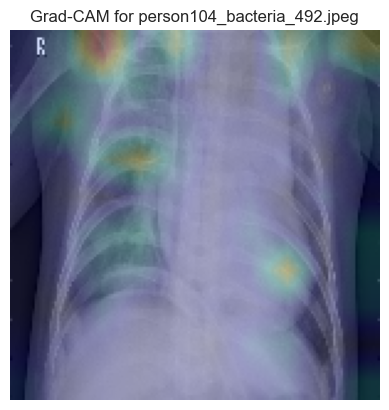

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
File: person108_bacteria_504.jpeg | Predicted class: [0.9993341]
Loss: 0.9993340969085693


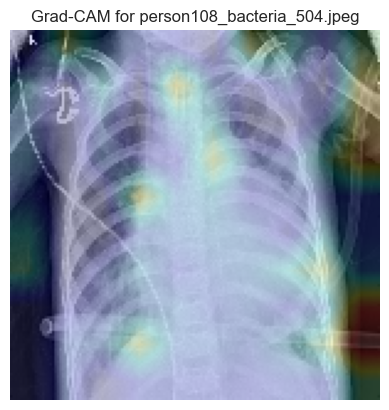

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
File: person108_bacteria_506.jpeg | Predicted class: [0.9994288]
Loss: 0.9994288086891174


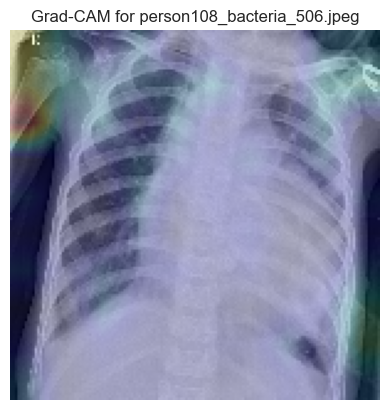

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
File: person108_bacteria_507.jpeg | Predicted class: [0.31826082]
Loss: 0.3182608187198639


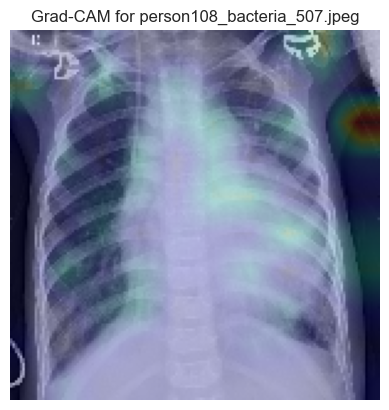

In [74]:
for img_path in pneumonia_images:
    run_gradcam_on_image(img_path, model=model_ran, last_conv_layer=last_conv_layer) 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
File: person100_bacteria_475.jpeg | Predicted class: [0.8673725]
Loss: 0.8673725128173828


C:\Users\salom\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['input_layer']
Received: inputs=Tensor(shape=(1, 150, 150, 1))
  warnings.warn(msg)


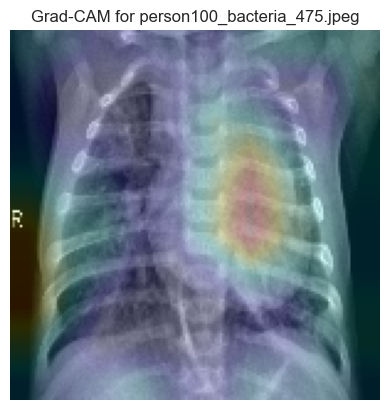

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
File: person100_bacteria_477.jpeg | Predicted class: [0.9922081]
Loss: 0.9922081828117371


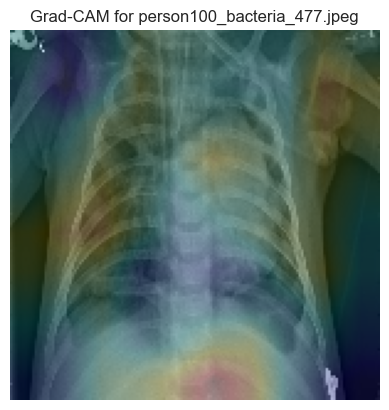

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: person100_bacteria_478.jpeg | Predicted class: [0.9999977]
Loss: 0.9999976754188538


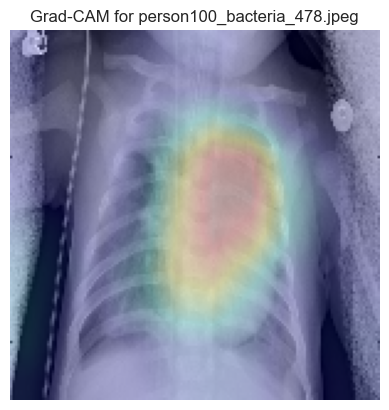

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
File: person100_bacteria_479.jpeg | Predicted class: [1.]
Loss: 1.0


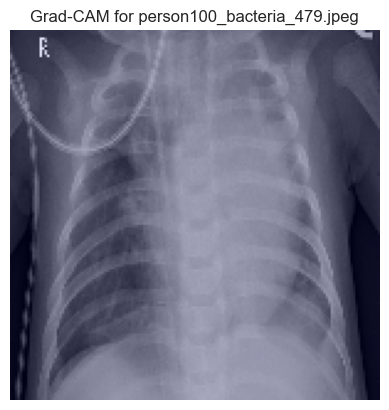

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
File: person100_bacteria_480.jpeg | Predicted class: [1.]
Loss: 1.0


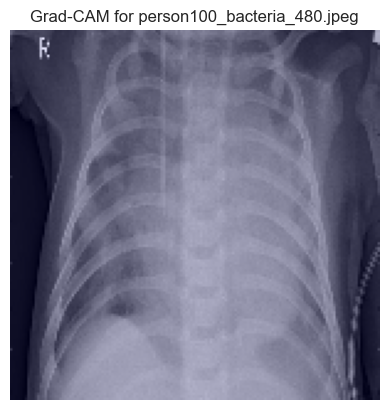

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
File: person100_bacteria_481.jpeg | Predicted class: [1.]
Loss: 1.0


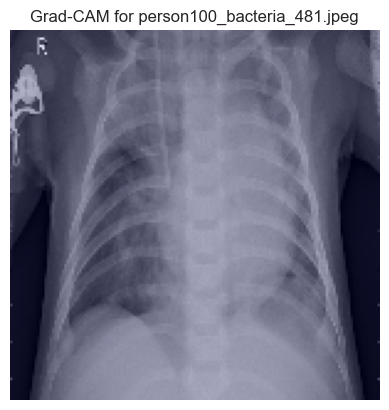

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
File: person100_bacteria_482.jpeg | Predicted class: [0.99999964]
Loss: 0.9999996423721313


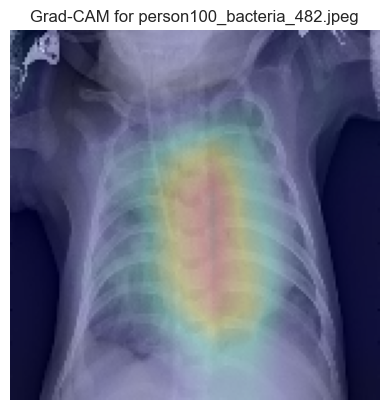

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: person101_bacteria_483.jpeg | Predicted class: [1.]
Loss: 1.0


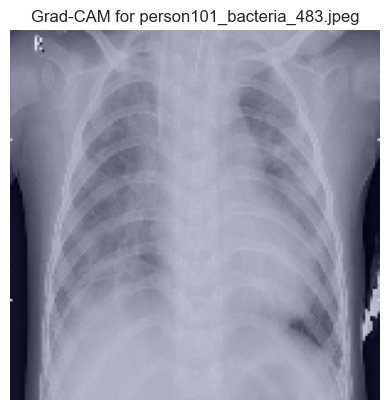

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
File: person101_bacteria_484.jpeg | Predicted class: [0.1552735]
Loss: 0.15527349710464478


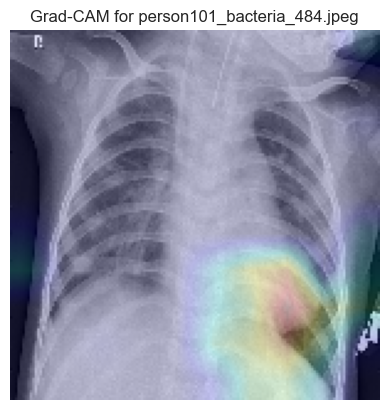

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
File: person101_bacteria_485.jpeg | Predicted class: [1.]
Loss: 1.0


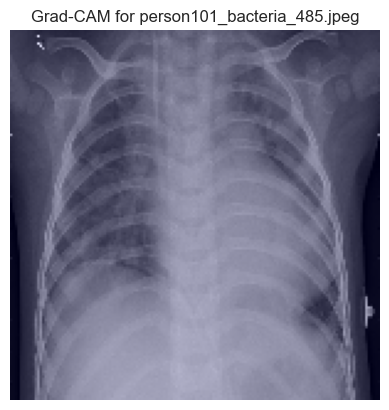

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
File: person101_bacteria_486.jpeg | Predicted class: [1.]
Loss: 1.0


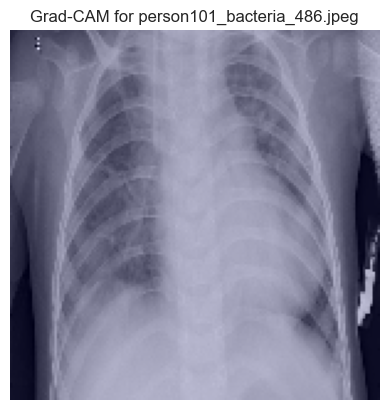

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
File: person102_bacteria_487.jpeg | Predicted class: [0.9014101]
Loss: 0.9014101028442383


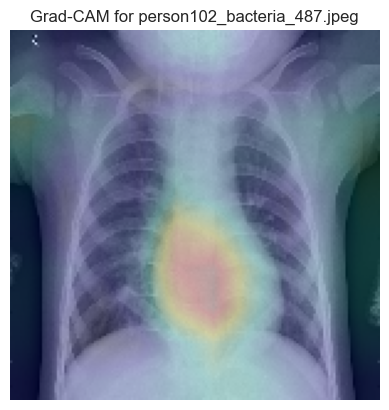

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
File: person103_bacteria_488.jpeg | Predicted class: [0.9999984]
Loss: 0.9999983906745911


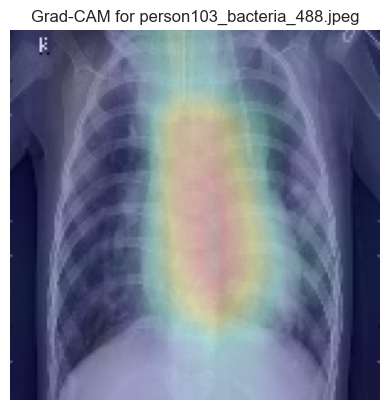

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
File: person103_bacteria_489.jpeg | Predicted class: [0.98978543]
Loss: 0.9897854328155518


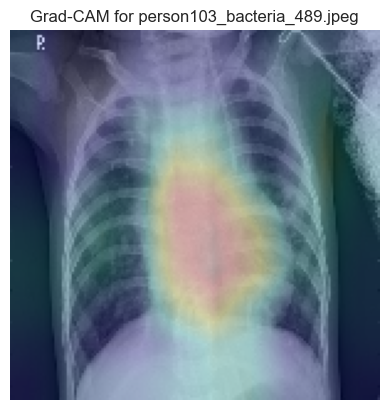

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
File: person103_bacteria_490.jpeg | Predicted class: [0.82918835]
Loss: 0.829188346862793


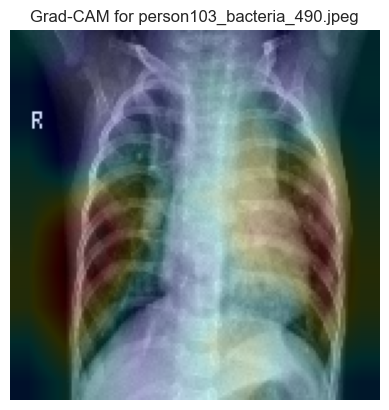

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
File: person104_bacteria_491.jpeg | Predicted class: [0.99999946]
Loss: 0.999999463558197


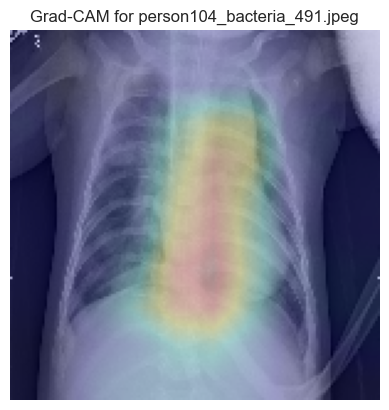

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
File: person104_bacteria_492.jpeg | Predicted class: [1.]
Loss: 1.0


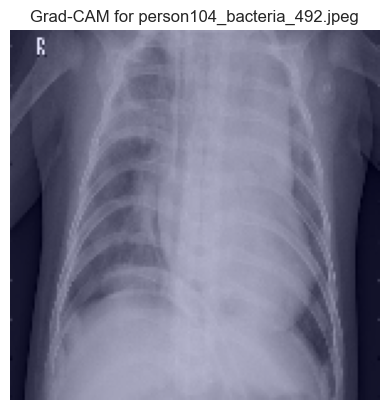

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
File: person108_bacteria_504.jpeg | Predicted class: [0.90510094]
Loss: 0.90510094165802


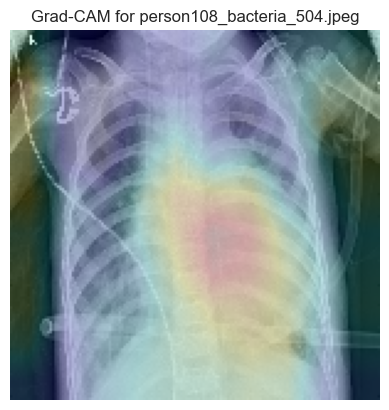

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: person108_bacteria_506.jpeg | Predicted class: [0.93252015]
Loss: 0.9325201511383057


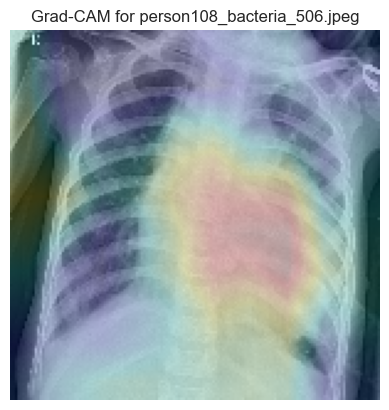

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
File: person108_bacteria_507.jpeg | Predicted class: [0.99814016]
Loss: 0.9981401562690735


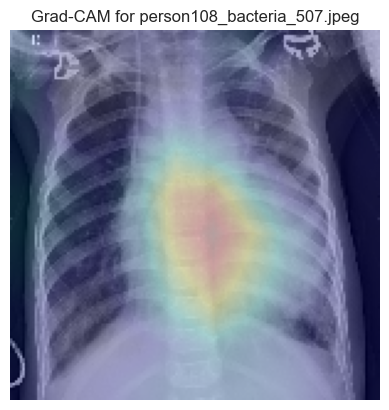

In [76]:
last_conv_layer = 'conv2d_4' 
for img_path in pneumonia_images:
    run_gradcam_on_image(img_path, model=model, last_conv_layer=last_conv_layer) 

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
File: IM-0001-0001.jpeg | Predicted class: [0.00501636]
Loss: 0.005016356706619263


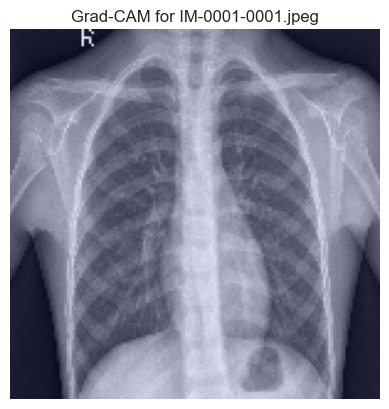

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
File: IM-0003-0001.jpeg | Predicted class: [7.555855e-05]
Loss: 7.555854972451925e-05


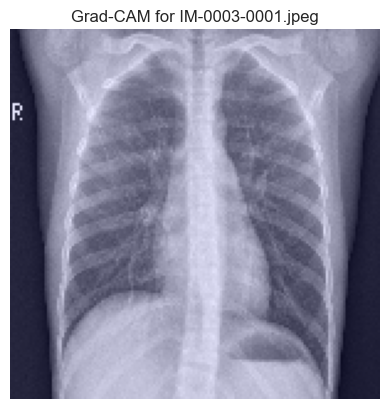

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
File: IM-0005-0001.jpeg | Predicted class: [0.0064578]
Loss: 0.006457800045609474


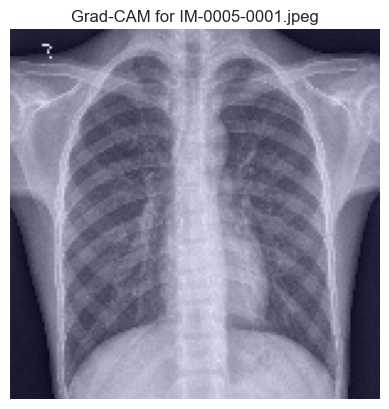

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
File: IM-0006-0001.jpeg | Predicted class: [0.01034089]
Loss: 0.010340891778469086


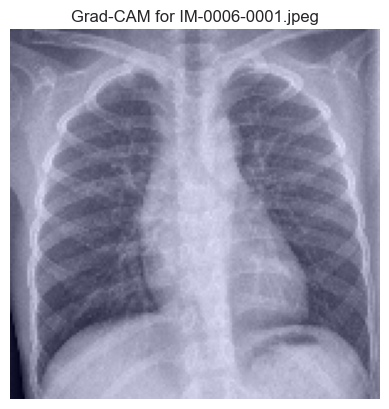

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
File: IM-0007-0001.jpeg | Predicted class: [0.00867693]
Loss: 0.008676929399371147


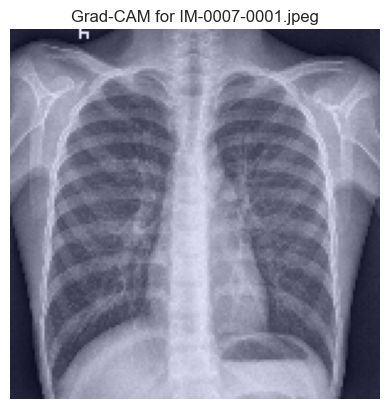

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
File: IM-0009-0001.jpeg | Predicted class: [3.981829e-05]
Loss: 3.981828558607958e-05


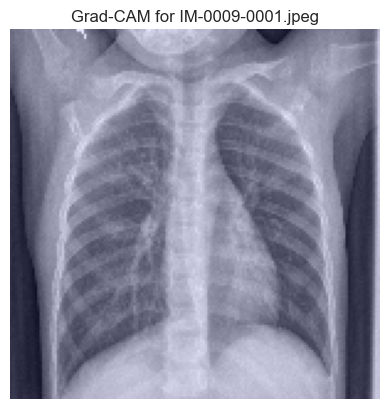

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
File: IM-0010-0001.jpeg | Predicted class: [0.00198033]
Loss: 0.0019803254399448633


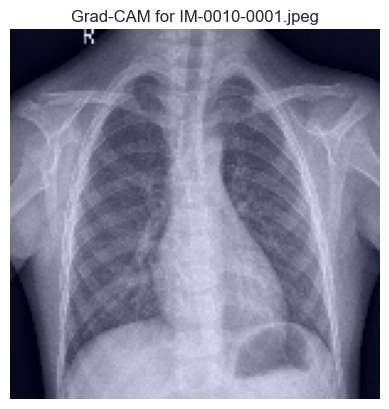

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
File: IM-0011-0001-0001.jpeg | Predicted class: [0.00422274]
Loss: 0.004222744144499302


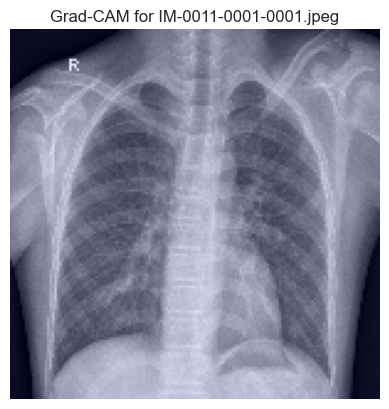

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: IM-0011-0001-0002.jpeg | Predicted class: [0.01491547]
Loss: 0.014915469102561474


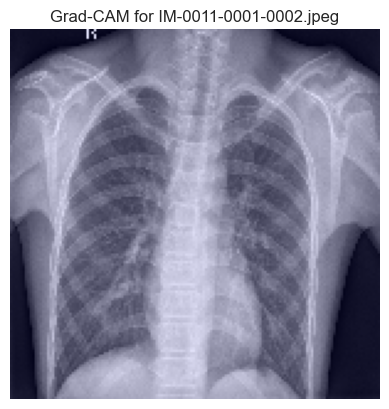

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
File: IM-0011-0001.jpeg | Predicted class: [0.00043642]
Loss: 0.0004364233755040914


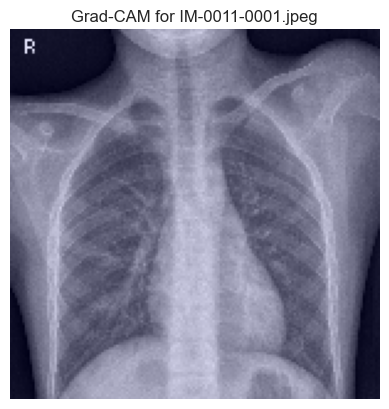

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: IM-0013-0001.jpeg | Predicted class: [0.00535171]
Loss: 0.005351714324206114


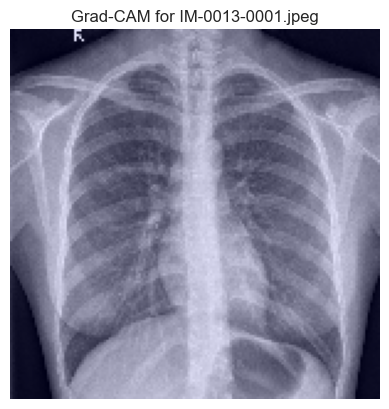

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
File: IM-0015-0001.jpeg | Predicted class: [0.0016197]
Loss: 0.001619701273739338


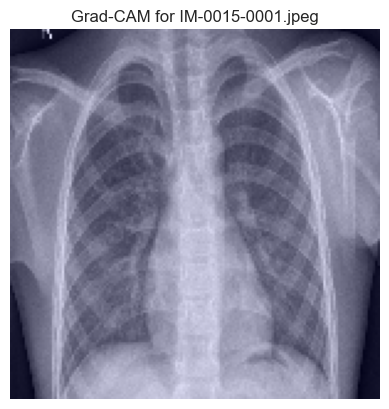

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
File: IM-0016-0001.jpeg | Predicted class: [0.00460194]
Loss: 0.004601945169270039


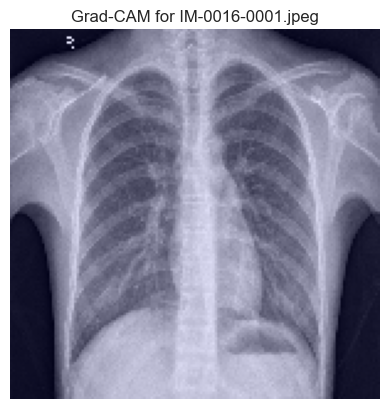

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
File: IM-0017-0001.jpeg | Predicted class: [0.00181236]
Loss: 0.0018123551271855831


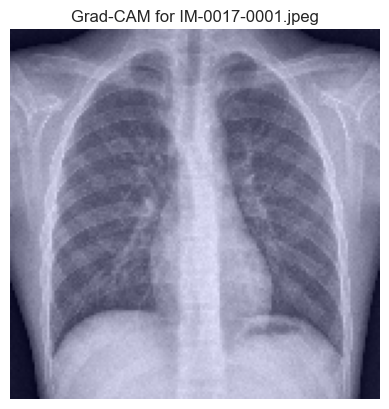

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
File: IM-0019-0001.jpeg | Predicted class: [0.01355443]
Loss: 0.013554433360695839


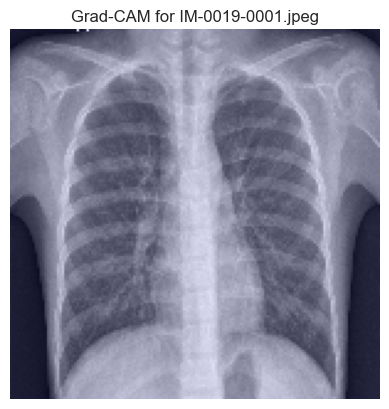

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
File: IM-0021-0001.jpeg | Predicted class: [0.00227678]
Loss: 0.0022767845075577497


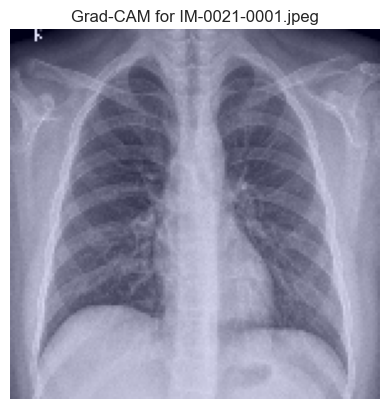

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
File: IM-0022-0001.jpeg | Predicted class: [0.9999958]
Loss: 0.9999958276748657


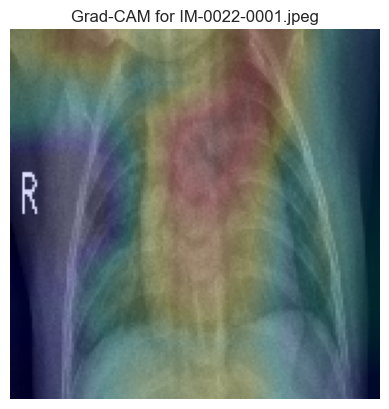

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
File: IM-0023-0001.jpeg | Predicted class: [0.00206031]
Loss: 0.0020603116136044264


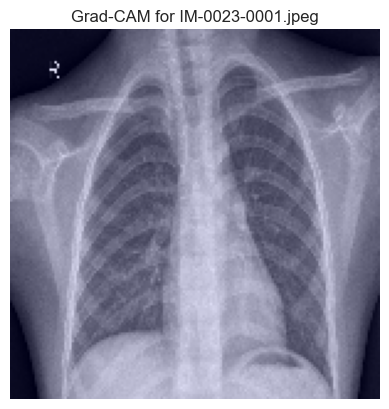

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
File: IM-0025-0001.jpeg | Predicted class: [0.01782143]
Loss: 0.017821433022618294


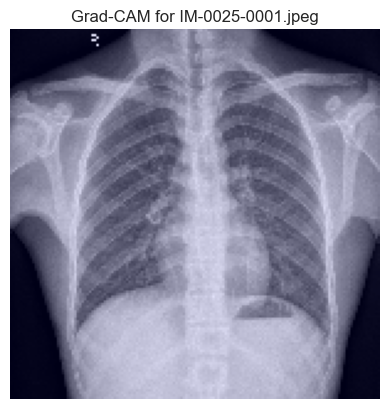

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
File: IM-0027-0001.jpeg | Predicted class: [0.00030656]
Loss: 0.00030656237504445016


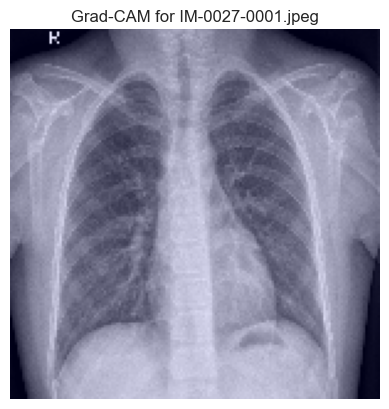

In [77]:
last_conv_layer = 'conv2d_4' 
for img_path in normal_images:
    run_gradcam_on_image(img_path, model=model, last_conv_layer=last_conv_layer) 